# Building a car classifier

Let's look at a slightly more interesting visual example than character or digit classification. Classifying cars. We'll use the Cars dataset from Jonathan Krause et al. at Stanford -- 16,185 images in 196 classes:

http://ai.stanford.edu/~jkrause/cars/car_dataset.html

The goal is to show all the steps of exploration and tuning on a new dataset, including false starts, etc. I deliberately didn't read lots of papers on this specific dataset or application, to better simulate working on an unfamiliar application. 

The plan going in:

- Load the dataset and do preliminary exploration. Since we're starting with a pre-labeled dataset we get to skip all the data cleaning.
- Do some preprocessing to prepare for building a model.
- Build a toy model on a small piece of the dataset to get a pipeline working
- Try to build an SUV/car/other classifier using just these images.
- Try transfer learning by fine-tuning squeezenet
- See how much we can gain via data augmentation
- Try the classifer on new images from the internet...
- if we want to go crazy, we can scrape a bunch more car photos from the internet and try out unsupervised pre-training. May be too much for this example.

In [1]:
# system
import os
import glob
import itertools as it
import operator
from collections import defaultdict
from StringIO import StringIO

# other libraries
import numpy as np 
import pandas as pd
import scipy.io  # for loading .mat files
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import Image
import seaborn as sns
import requests
import imagehash # for phash -- comparing images

In [2]:
# my code
from display import visualize_keras_model, plot_training_curves

Using TensorFlow backend.


In [4]:
%matplotlib inline
sns.set_style("white")
p = sns.color_palette()

# repeatability:
np.random.seed(42)

In [5]:
data_root = os.path.expanduser("~/data/cars")

# Data exploration

Let's take a look at the structure of the dataset.

In [6]:
os.listdir(data_root)

['car_ims', 'car_ims.tgz', 'cars_annos.mat', 'resized_car_ims', 'source.txt']

Let's look at the annotations first.

In [13]:
cars_annos = scipy.io.loadmat(os.path.join(data_root, 'cars_annos.mat'))

In [15]:
cars_annos.keys()

['annotations', '__version__', '__header__', 'class_names', '__globals__']

Class names seems promising. Let's take a look.

In [20]:
cars_annos['class_names']

array([[array([u'AM General Hummer SUV 2000'], 
      dtype='<U26'),
        array([u'Acura RL Sedan 2012'], 
      dtype='<U19'),
        array([u'Acura TL Sedan 2012'], 
      dtype='<U19'),
        array([u'Acura TL Type-S 2008'], 
      dtype='<U20'),
        array([u'Acura TSX Sedan 2012'], 
      dtype='<U20'),
        array([u'Acura Integra Type R 2001'], 
      dtype='<U25'),
        array([u'Acura ZDX Hatchback 2012'], 
      dtype='<U24'),
        array([u'Aston Martin V8 Vantage Convertible 2012'], 
      dtype='<U40'),
        array([u'Aston Martin V8 Vantage Coupe 2012'], 
      dtype='<U34'),
        array([u'Aston Martin Virage Convertible 2012'], 
      dtype='<U36'),
        array([u'Aston Martin Virage Coupe 2012'], 
      dtype='<U30'),
        array([u'Audi RS 4 Convertible 2008'], 
      dtype='<U26'),
        array([u'Audi A5 Coupe 2012'], 
      dtype='<U18'),
        array([u'Audi TTS Coupe 2012'], 
      dtype='<U19'),
        array([u'Audi R8 Coupe 2012'], 
  

Funny structure. Let's turn it into a flat list.

In [22]:
classes = [x[0] for x in cars_annos['class_names'][0]]
classes[:10]

[u'AM General Hummer SUV 2000',
 u'Acura RL Sedan 2012',
 u'Acura TL Sedan 2012',
 u'Acura TL Type-S 2008',
 u'Acura TSX Sedan 2012',
 u'Acura Integra Type R 2001',
 u'Acura ZDX Hatchback 2012',
 u'Aston Martin V8 Vantage Convertible 2012',
 u'Aston Martin V8 Vantage Coupe 2012',
 u'Aston Martin Virage Convertible 2012']

Looks good. Now let's split into (brand, model, type, year tuples). This will require a bit of manual munging...

In [38]:
first, years = zip(*[(s[:-5], s[-4:])
                     for s in classes])

In [33]:
# Check years...
sorted(pd.unique(years))

[u'1991',
 u'1993',
 u'1994',
 u'1997',
 u'1998',
 u'1999',
 u'2000',
 u'2001',
 u'2002',
 u'2006',
 u'2007',
 u'2008',
 u'2009',
 u'2010',
 u'2011',
 u'2012']

In [34]:
first[:5]

(u'AM General Hummer SUV',
 u'Acura RL Sedan',
 u'Acura TL Sedan',
 u'Acura TL Type-S',
 u'Acura TSX Sedan')

In [44]:
# Ok, let's pull out the car types
models, car_types = zip(*[(s.split()[:-1], s.split()[-1])
                         for s in first])

In [43]:
pd.unique(car_types)

array([u'SUV', u'Sedan', u'Type-S', u'R', u'Hatchback', u'Convertible',
       u'Coupe', u'Wagon', u'GS', u'Cab', u'ZR1', u'Z06', u'SS', u'Van',
       u'Minivan', u'SRT-8', u'SRT8', u'Abarth', u'SuperCab', u'IPL',
       u'XKR', u'Superleggera'], dtype=object)

Hmm. Car types are a bit messy -- many are multi-word. We'll want to clean this up later -- I don't know cars well enough to classify without seeing example images, so let's go to that.

In [50]:
images_dir = os.path.join(data_root, "car_ims")
len(os.listdir(images_dir))

16185

Ok, so we have our 16K images. Let's look at a few random ones.

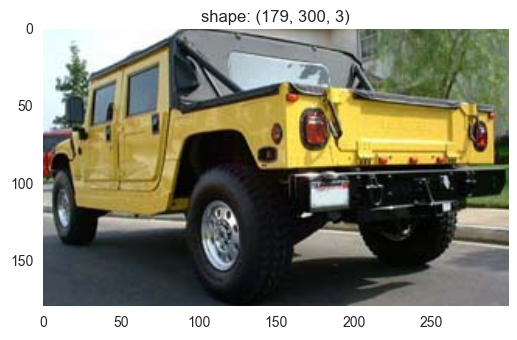

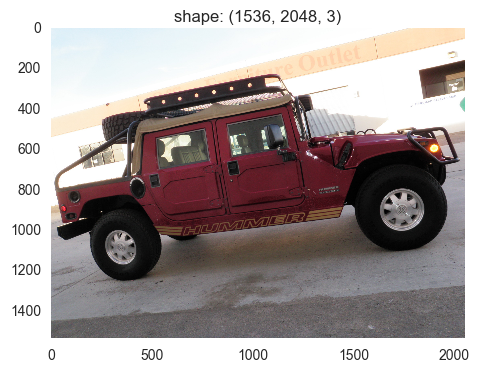

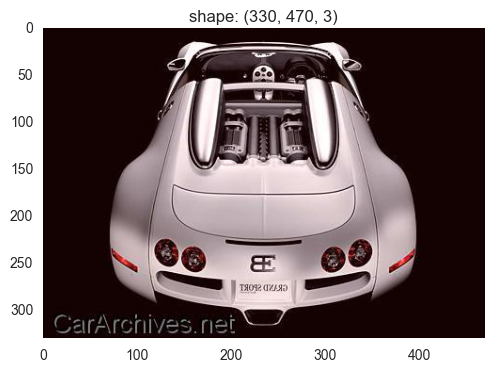

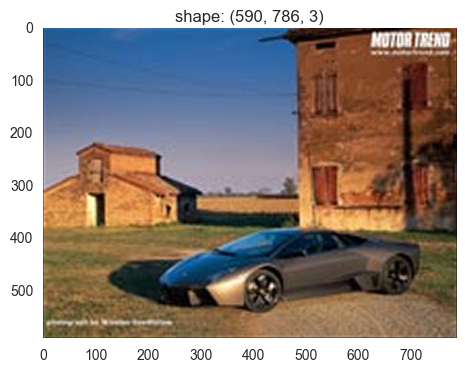

In [60]:
image_paths = os.listdir(images_dir)
for i in [12, 35, 3600, 12345]:
    img = mpimg.imread(os.path.join(images_dir, image_paths[i]))
    
    fig, ax = plt.subplots()
    ax.imshow(img)
    ax.set_title('shape: '+ str(img.shape))
    ax.grid(False)

Ok, we can read the images. They appear to be of vastly different sizes. Let's take a closer look.

In [102]:
shapes = [mpimg.imread(os.path.join(images_dir, path)).shape
          for path in image_paths]

No errors! It's nice to have clean data...

In [103]:
widths = [s[0] for s in shapes]
aspect_ratios = [s[0]/float(s[1]) for s in shapes]

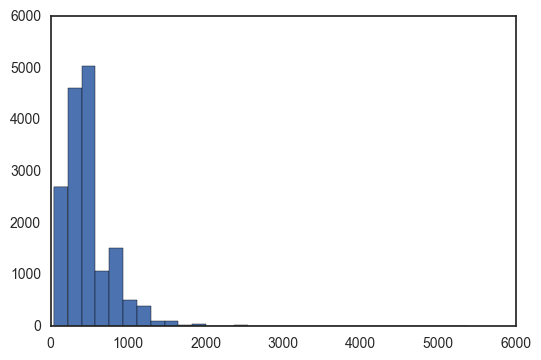

In [104]:
plt.hist(widths, bins=30);

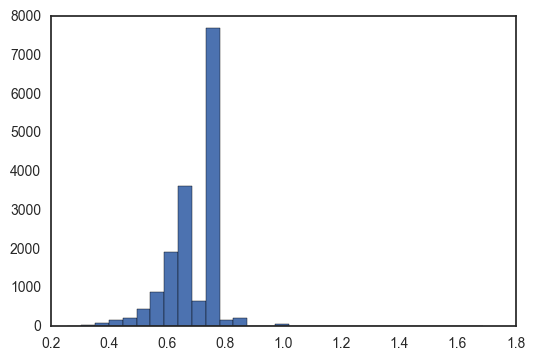

In [107]:
plt.hist(aspect_ratiosct_ratios, bins=30);

Ok, now let's get the classes for each image -- we need to look at the annotations part of the dict... 

In [69]:
len(cars_annos['annotations'])

1

In [71]:
len(cars_annos['annotations'][0])

16185

In [73]:
cars_annos['annotations'][0][0]

([u'car_ims/000001.jpg'], [[112]], [[7]], [[853]], [[717]], [[1]], [[0]])

In [76]:
# what are the fields?
cars_annos['annotations'].dtype

dtype([('relative_im_path', 'O'), ('bbox_x1', 'O'), ('bbox_y1', 'O'), ('bbox_x2', 'O'), ('bbox_y2', 'O'), ('class', 'O'), ('test', 'O')])

In [84]:
# get rid of the nested arrays
from collections import namedtuple
Example = namedtuple('Example',
                     ['rel_path', 'x1', 'y1', 'x2','y2','cls','test'])
# silly nested nested lists...
examples = [Example(*[a.flatten()[0] for a in x])
           for x in cars_annos['annotations'][0]]

In [83]:
examples[0]

Example(rel_path=u'car_ims/000001.jpg', x1=112, y1=7, x2=853, y2=717, cls=1, test=0)

Ok, that worked. Now let's look at a couple of images from each class.

In [90]:
key_fn = operator.attrgetter('cls')
by_class = {} # key -> lst
for cls, group in it.groupby(sorted(examples, key=key_fn), key_fn):
    by_class[cls] = list(group) 

In [96]:
sorted(by_class.keys())[:5]  # note: classes start at 1, not 0

[1, 2, 3, 4, 5]

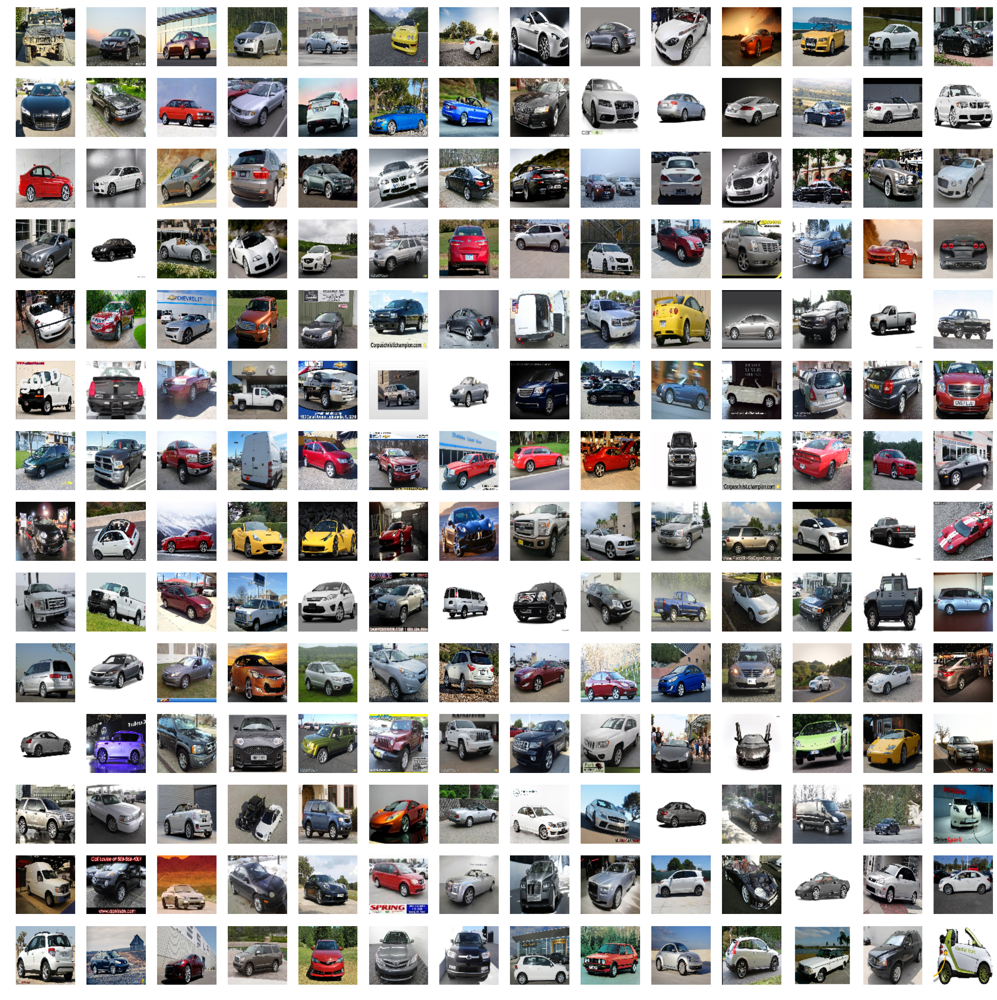

In [101]:
# 196 = 14*14
fig, plots = plt.subplots(14,14, sharex='all', sharey='all',
                         figsize=(28,28))
for i in range(196):
    # read the image
    rel_path = by_class[i+1][0].rel_path
    # Note: rel_paths include 'car_ims/'
    img = Image.open(os.path.join(data_root, rel_path))
    img = img.resize((100,100))
    plots[i // 14, i % 14].axis('off')
    plots[i // 14, i % 14].imshow(img)


Pretty! :)

In [111]:
# Which classes have the most examples?
counts = sorted([(k, classes[k-1], len(by_class[k]))
                 for k in by_class.keys()], 
                reverse=True,
               key=operator.itemgetter(2))

In [121]:
print("5 most frequent:\n")
print("\n".join(map(str, counts[:5])))
print("\n5 least frequent:\n")
print("\n".join(map(str, counts[-5:])))

5 most frequent:

(119, u'GMC Savana Van 2012', 136)
(79, u'Chrysler 300 SRT-8 2010', 97)
(161, u'Mercedes-Benz 300-Class Convertible 1993', 96)
(167, u'Mitsubishi Lancer Sedan 2012', 95)
(56, u'Chevrolet Corvette ZR1 2012', 93)

5 least frequent:

(175, u'Rolls-Royce Phantom Drophead Coupe Convertible 2012', 61)
(64, u'Chevrolet Express Cargo Van 2007', 59)
(158, u'Maybach Landaulet Convertible 2012', 58)
(99, u'FIAT 500 Abarth 2012', 55)
(136, u'Hyundai Accent Sedan 2012', 48)


# Preprocessing

Ok, now that we have a sense of what the dataset looks like, let's do some preprocessing.


- We'll want fixed size (227x227) images. Will need to decide whether to just resize, use the provided bounding boxes, resize + crop, etc. 
- may also want to convert to grayscale.
- For now, let's just resize all to 227x227. It'll screw up the aspect ratios a bit, but is a reasonable place to start. How much space will that take if we store the images uncompressed?


In [123]:
# 12 bytes per pixel. Size in MB.
16100 * 227 * 227 * 12 / 1024 / 1024

9494

9.5G is a bit much. Let's keep in jpg for now, and decode on the fly. (Could try both and see what's faster...)

In [126]:
images_dir

'/Users/shnayder/data/cars/car_ims'

In [127]:
resized_path = os.path.join(data_root,'resized_car_ims')
if not os.path.exists(resized_path):
    os.mkdir(resized_path)    

In [133]:
# Resize all the things. Will take a little while.
for fname in image_paths:
    new_path = os.path.join(resized_path, fname)
    # skip if already exists. 
    # (Blow away whole directory if there's a problem, or to change
    # resize strategy)
    if not os.path.exists(new_path):
        img = Image.open(os.path.join(images_dir, fname))
        img = img.resize((227,227))
        img.save(new_path)

In [134]:
# double check
len(os.listdir(resized_path))

16185

In [135]:
!du -shc {resized_path} {images_dir}

219M	/Users/shnayder/data/cars/resized_car_ims
1.9G	/Users/shnayder/data/cars/car_ims
2.1G	total


Get a smaller dataset to process. Will make for faster processing.

# Toy problem

Ok, now we have standard size images and roughly understand what things look like. Let's start with a toy problem to get our code working.

**Problem 1: distinguishing Hummers from the Acura sedan.**

Let's get our training, validation, and test data prepared. We'll just keep it in-memory, at least for now.

In [193]:
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Convolution2D, MaxPooling2D
from keras.utils import np_utils

Using TensorFlow backend.


In [177]:
def gray_to_rgb(im):
    """
    Noticed (due to array projection error in code below) that there is at least
    one grayscale image in the dataset.
    We'll use this to convert.
    """
    w, h = im.shape
    ret = np.empty((w,h,3), dtype=np.uint8)
    ret[:,:,0] = im
    ret[:,:,1] = im
    ret[:,:,2] = im
    return ret

In [179]:
def load_examples(by_class, cls):
    """
    Load examples for a class. Ignores test/train distinction -- 
    we'll do our own train/validation/test split later.
    
    Args:
        by_class: our above dict -- class_id -> [Example()]
        cls: which class to load
        
    Returns:
        list of (X,y) tuples, one for each image.
            X: 3x227x227 ndarray of type uint8
            Y: class_id (will be equal to cls)
    """
    res = []
    for ex in by_class[cls]:
        # load the resized image!
        img_path = os.path.join(data_root, 
                        ex.rel_path.replace('car_ims', 'resized_car_ims'))
        img = mpimg.imread(img_path)
        # handle any grayscale images
        if len(img.shape) == 2:
            img = gray_to_rgb(img)
        res.append((img, cls))
    return res

In [149]:
def split_examples(xs, valid_frac, test_frac):
    """
    Randomly splits the xs array into train, valid, test, with specified 
    percentages. Rounds down.
    
    Returns:
        (train, valid, test)
    """
    assert valid_frac + test_frac < 1
    
    n = len(xs)
    valid = int(valid_frac * n)
    test = int(test_frac * n)
    train = n - valid - test
    
    # don't change passed-in list
    shuffled = xs[:]
    np.random.shuffle(shuffled)

    return (shuffled[:train], 
            shuffled[train:train + valid], 
            shuffled[train + valid:])

# quick test
split_examples(range(10), 0.2, 0.4)

([9, 2, 0, 6], [8, 5], [3, 7, 1, 4])

In [180]:
valid_frac = 0.2
test_frac = 0.2
# load the Hummer and acura images
(train, valid, test) = split_examples(load_examples(by_class, 1),
                                     valid_frac, test_frac)
(train2, valid2, test2) = split_examples(load_examples(by_class, 2),
                                     valid_frac, test_frac)

train.extend(train2)
valid.extend(valid2)
test.extend(test2)

# ...and shuffle to make training work better.
np.random.shuffle(train)
np.random.shuffle(valid)
np.random.shuffle(test)

In [305]:
# We have lists of (X,Y) tuples. Let's unzip into lists of Xs and Ys.
X_train, Y_train = zip(*train)
X_valid, Y_valid = zip(*valid)
X_test, Y_test = zip(*test)

# and turn into np arrays of the right dimension.
def convert_X(xs):
    '''
    Take list of (w,h,3) images.
    Turn into an np array, change type to float32.
    '''
    return np.array(xs).astype('float32')
    
X_train = convert_X(X_train)
X_valid = convert_X(X_valid)
X_test = convert_X(X_test)

In [333]:
# Note that despite lots of Keras examples online that want the data to have shape 3,w,h,
# we actually want w,h,3 when using the TensorFlow backend.
X_train.shape

(95, 227, 227, 3)

Convert labels to one-hot. First, we need to make sure they're sequential starting from 0.

In [307]:
all_ys = sorted(set(Y_train).union(set(Y_valid)).union(set(Y_test)))
n_classes = len(all_ys)
mapping = dict(zip(all_ys, range(n_classes)))
mapping

{1: 0, 2: 1}

In [308]:
def convert_Y(ys, mapping):
    '''
    Convert to np array, make class values sequential from 0, 
    and make one-hot
    '''
    ret = np.array([mapping[y] for y in ys])
    n_classes = len(mapping)
    return np_utils.to_categorical(ret, n_classes)

Y_train = convert_Y(Y_train, mapping)
Y_valid = convert_Y(Y_valid, mapping)
Y_test = convert_Y(Y_test, mapping)

In [309]:
Y_train.shape

(95, 2)

Let's build a simple logistic classifier. We'll convert to grayscale to make this easier...

In [310]:
X_train[0].mean(axis=2).shape

(227, 227)

In [311]:
def normalize_to_gray(xs):
    ret = (xs / 255.0).mean(axis=3)
    return np.reshape(ret, (-1, 227*227))

X_train_gray = normalize_to_gray(X_train)
X_valid_gray = normalize_to_gray(X_valid)
X_test_gray = normalize_to_gray(X_test)

In [312]:
X_train_gray[0].shape

(51529,)

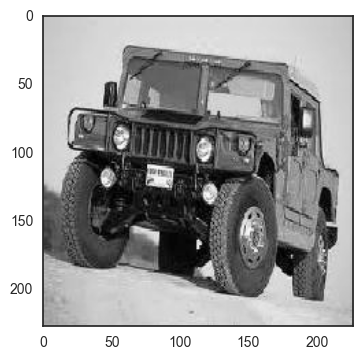

In [313]:
# (1-x) because grayscale images are backwards--1 is black, it appears
plt.imshow((1 - X_train_gray[0]).reshape((227,227)))

In [244]:
def logistic_model():
    model = Sequential()
    # should really use lower resolution if we're making this silly
    # of a model
    model.add(Dense(output_dim=2, input_dim=227*227))
    model.add(Activation('softmax'))

    return model

model = logistic_model()
model.compile(loss='categorical_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy'])

In [314]:
Y_train.shape

(95, 2)

In [268]:
history = model.fit(X_train_gray, Y_train,
                    batch_size=16, nb_epoch=100, verbose=1,
         validation_data=(X_valid_gray, Y_valid))

Train on 95 samples, validate on 29 samples
Epoch 1/100
95/95 [==============================] - 0s - loss: 0.1702 - acc: 0.9895 - val_loss: 1.6879 - val_acc: 0.6207
Epoch 2/100
95/95 [==============================] - 0s - loss: 0.1702 - acc: 0.9895 - val_loss: 1.6164 - val_acc: 0.6207
Epoch 3/100
95/95 [==============================] - 0s - loss: 0.1721 - acc: 0.9895 - val_loss: 4.3732 - val_acc: 0.5517
Epoch 4/100
95/95 [==============================] - 0s - loss: 0.6450 - acc: 0.8737 - val_loss: 1.6594 - val_acc: 0.5862
Epoch 5/100
95/95 [==============================] - 0s - loss: 0.1709 - acc: 0.9895 - val_loss: 1.6182 - val_acc: 0.6207
Epoch 6/100
95/95 [==============================] - 0s - loss: 0.1702 - acc: 0.9895 - val_loss: 1.6181 - val_acc: 0.6207
Epoch 7/100
95/95 [==============================] - 0s - loss: 0.1702 - acc: 0.9895 - val_loss: 1.6202 - val_acc: 0.6207
Epoch 8/100
95/95 [==============================] - 0s - loss: 0.1701 - acc: 0.9895 - val_loss: 1.622

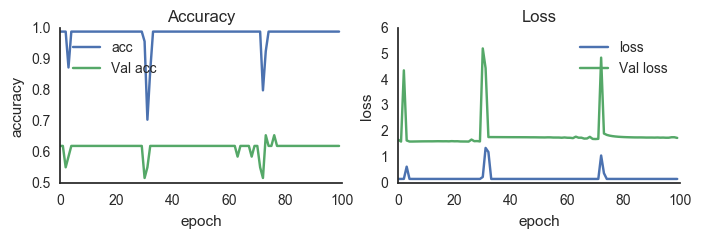

In [269]:
plot_training_curves(history.history);

In [270]:
score = model.evaluate(X_test_gray, Y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

('Test loss:', 1.3914583921432495)
('Test accuracy:', 0.75862067937850952)


In [283]:
predict_train = model.predict(X_train_gray)
predict_valid = model.predict(X_valid_gray)
predict_test = model.predict(X_test_gray)

Surprise! It's hugely overfitting, with 50K parameters and a couple of hundred images. Not very useful. 

We'll see if a simple conv net will do a bit better. Then we can try data augmentation, regularization, and perhaps making our problem simpler by using the bounding boxes. First though, let's put together a bit more infrastructure: 

* looking at training and test examples, right and wrong
* let's set up tensorboard so we can look at weight distributions

In [392]:
# Look at training data -- there's so little we can look at all of it

def plot_data(xs, ys, predicts):
    """Plot the images in xs, with corresponding correct labels
    and predictions.
    
    Args:
        xs: RGB or grayscale images with float32 values in [0,1].
        ys: one-hot encoded labels
        predicts: probability vectors (same dim as ys, normalized e.g. via softmax)
    """
    
    # sort all 3 by ys
    xs, ys, ps = zip(*sorted(zip(xs, ys, predicts), 
                             key=lambda tpl: tpl[1][0]))
    n = len(xs)
    rows = (n+9)/10
    fig, plots = plt.subplots(rows,10, sharex='all', sharey='all',
                             figsize=(20,2*rows), squeeze=False)
    for i in range(n):
        # read the image
        ax = plots[i // 10, i % 10]
        ax.axis('off')
        img = xs[i].reshape(227,227,-1) 

        if img.shape[-1] == 1: # Grayscale
            # Get rid of the unneeded dimension
            img = img.squeeze()
            # flip grayscale:
            img = 1-img 
            
        ax.imshow(img)
        # dot with one-hot vector picks out right element
        pcorrect = np.dot(ps[i], ys[i]) 
        if pcorrect > 0.8:
            color = "blue"
        else:
            color = "red"
        ax.set_title("{}   p={:.2f}".format(int(ys[i][0]), pcorrect),
                     loc='center', fontsize=18, color=color)
    return fig

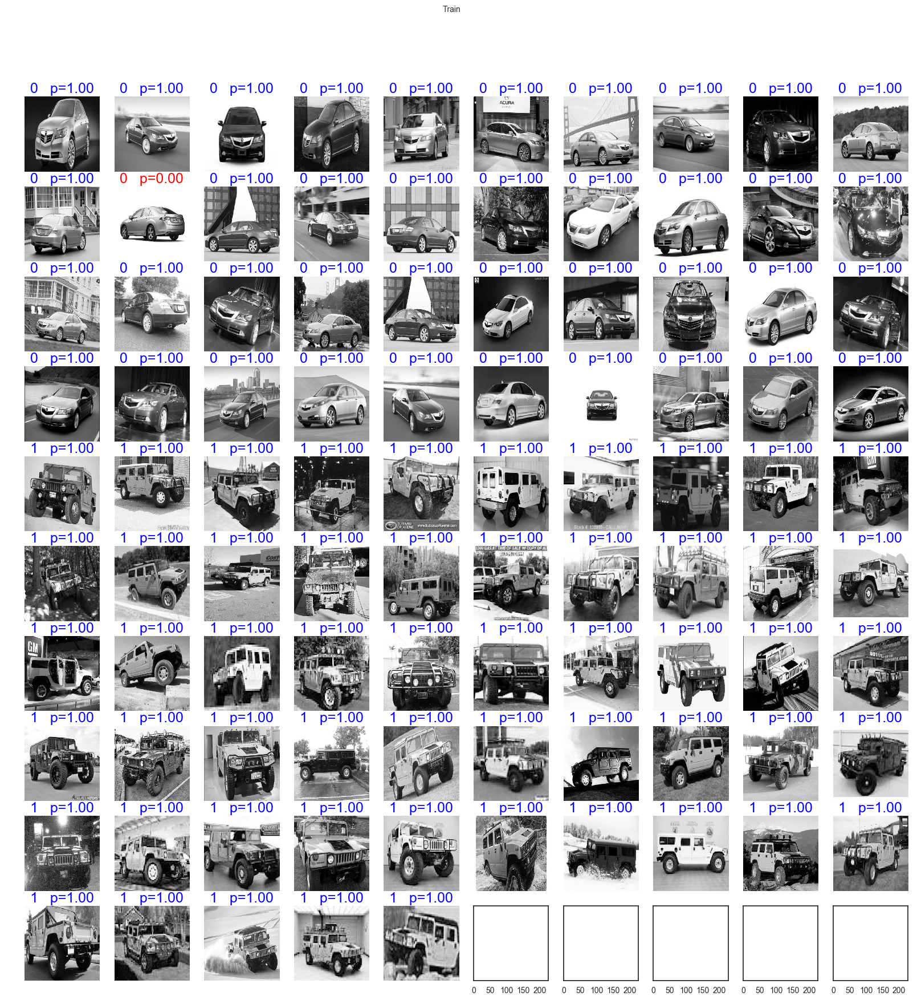

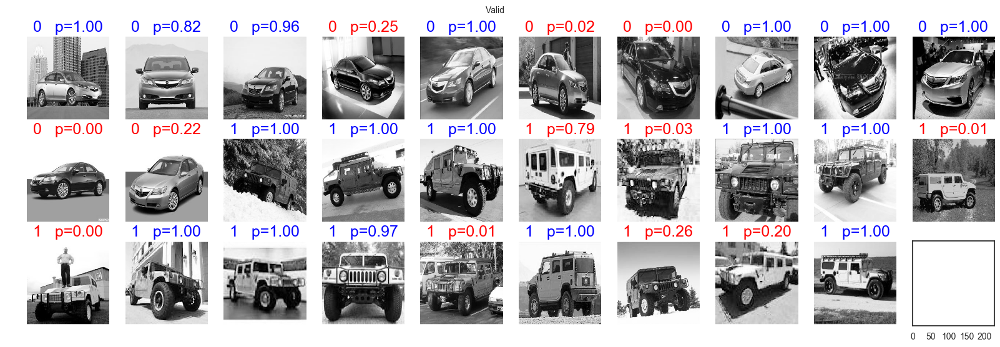

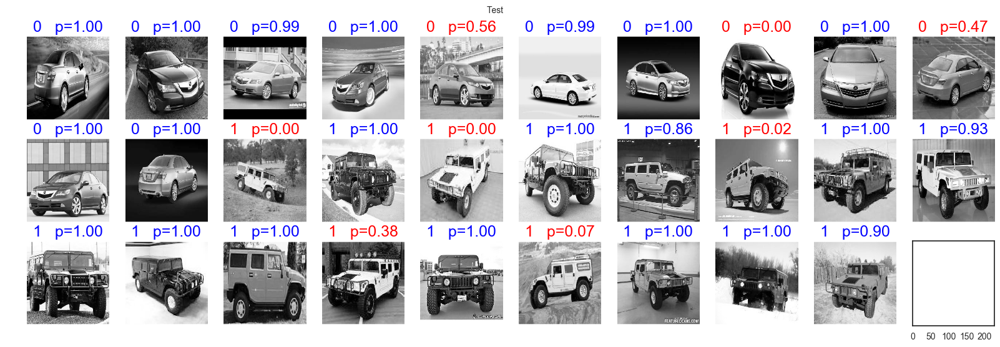

In [294]:
fig = plot_data(X_train_gray, Y_train, predict_train)
fig.suptitle("Train")

fig = plot_data(X_valid_gray, Y_valid, predict_valid)
fig.suptitle("Valid")

fig = plot_data(X_test_gray, Y_test, predict_test)
fig.suptitle("Test")

Looking at this really highlights how little data we have. Probably not worth using 40% for validation and test. Cross-validation would be better, and with this little data, would probably be fast enough. Can definitely benefit from data augmentation too. 

On the other hand, looks like the images are pretty well centered -- bounding boxes might help a bit, but there are very few gross scale differences.

While we're building infrastructure, let's change above plots to include whether we got each example right and wrong.

### Now, let's try a basic CNN

We'll use three conv layers, then fully connected one. We'll use dropout to try to fight overfitting...

In [315]:
# normalize the data, this time leaving it in color
def normalize_for_cnn(xs):
    ret = (xs / 255.0)
    return ret

X_train_norm = normalize_for_cnn(X_train)
X_valid_norm = normalize_for_cnn(X_valid)
X_test_norm = normalize_for_cnn(X_test)

In [316]:
X_train_norm.shape

(95, 227, 227, 3)

In [322]:
def cnn_model():
    model = Sequential()
    nb_filters = 16
    pool_size = (2,2)
    filter_size = 3
    nb_classes = 2
    model.add(Convolution2D(nb_filters, filter_size, filter_size,
                        input_shape=(227, 227, 3)))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.5))
    
    model.add(Convolution2D(nb_filters, filter_size, filter_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.5))

    model.add(Convolution2D(nb_filters, filter_size, filter_size))
    model.add(Activation('relu'))
    model.add(MaxPooling2D(pool_size=pool_size))
    model.add(Dropout(0.5))
    
    model.add(Flatten())
    model.add(Dense(16))
    model.add(Activation('relu'))
    model.add(Dropout(0.5))
    model.add(Dense(nb_classes))
    model.add(Activation('softmax'))
    return model

model2 = cnn_model()
model2.compile(loss='categorical_crossentropy',
              optimizer='adadelta',
              metrics=['accuracy'])

In [323]:
print(model2.summary())


____________________________________________________________________________________________________
Layer (type)                     Output Shape          Param #     Connected to                     
convolution2d_19 (Convolution2D) (None, 225, 225, 16)  448         convolution2d_input_11[0][0]     
____________________________________________________________________________________________________
activation_26 (Activation)       (None, 225, 225, 16)  0           convolution2d_19[0][0]           
____________________________________________________________________________________________________
maxpooling2d_16 (MaxPooling2D)   (None, 112, 112, 16)  0           activation_26[0][0]              
____________________________________________________________________________________________________
dropout_17 (Dropout)             (None, 112, 112, 16)  0           maxpooling2d_16[0][0]            
___________________________________________________________________________________________

In [325]:
recompute = False

if recompute:
    history = model2.fit(X_train_norm, Y_train, batch_size=16, nb_epoch=100, verbose=1,
         validation_data=(X_valid_norm, Y_valid))
else:
    model2.load_weights('hummer_acura_simple_cnn.h5'

Train on 95 samples, validate on 29 samples
Epoch 1/100
95/95 [==============================] - 4s - loss: 0.7050 - acc: 0.4842 - val_loss: 0.6891 - val_acc: 0.5862
Epoch 2/100
95/95 [==============================] - 4s - loss: 0.6873 - acc: 0.6000 - val_loss: 0.6882 - val_acc: 0.5862
Epoch 3/100
95/95 [==============================] - 3s - loss: 0.6985 - acc: 0.5684 - val_loss: 0.6902 - val_acc: 0.5862
Epoch 4/100
95/95 [==============================] - 4s - loss: 0.6840 - acc: 0.5789 - val_loss: 0.6873 - val_acc: 0.5862
Epoch 5/100
95/95 [==============================] - 4s - loss: 0.6717 - acc: 0.5895 - val_loss: 0.6844 - val_acc: 0.5862
Epoch 6/100
95/95 [==============================] - 4s - loss: 0.6884 - acc: 0.5895 - val_loss: 0.6874 - val_acc: 0.5862
Epoch 7/100
95/95 [==============================] - 4s - loss: 0.6670 - acc: 0.6105 - val_loss: 0.6834 - val_acc: 0.6552
Epoch 8/100
95/95 [==============================] - 4s - loss: 0.6573 - acc: 0.6105 - val_loss: 0.682

In [326]:
model2.save('hummer_acura_simple_cnn.h5')

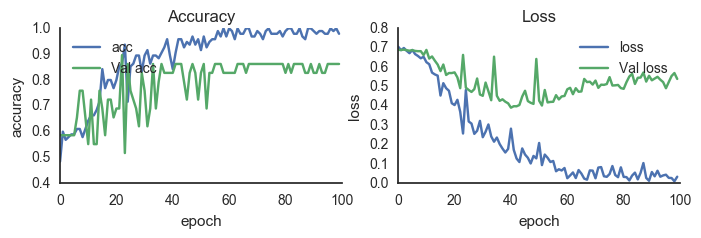

In [327]:
plot_training_curves(history.history);

In [329]:
score = model2.evaluate(X_test_norm, Y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

('Test loss:', 0.24457170069217682)
('Test accuracy:', 0.89655172824859619)


Hmm. Seems to work remarkably well, given how little data we have! Yay for dropout. We can move on to a more interesting problem, but first, let's take a look at the network in a bit more detail, and try it on some hummer, acura, and other photos from the internet.

First, let's take a look at the results:

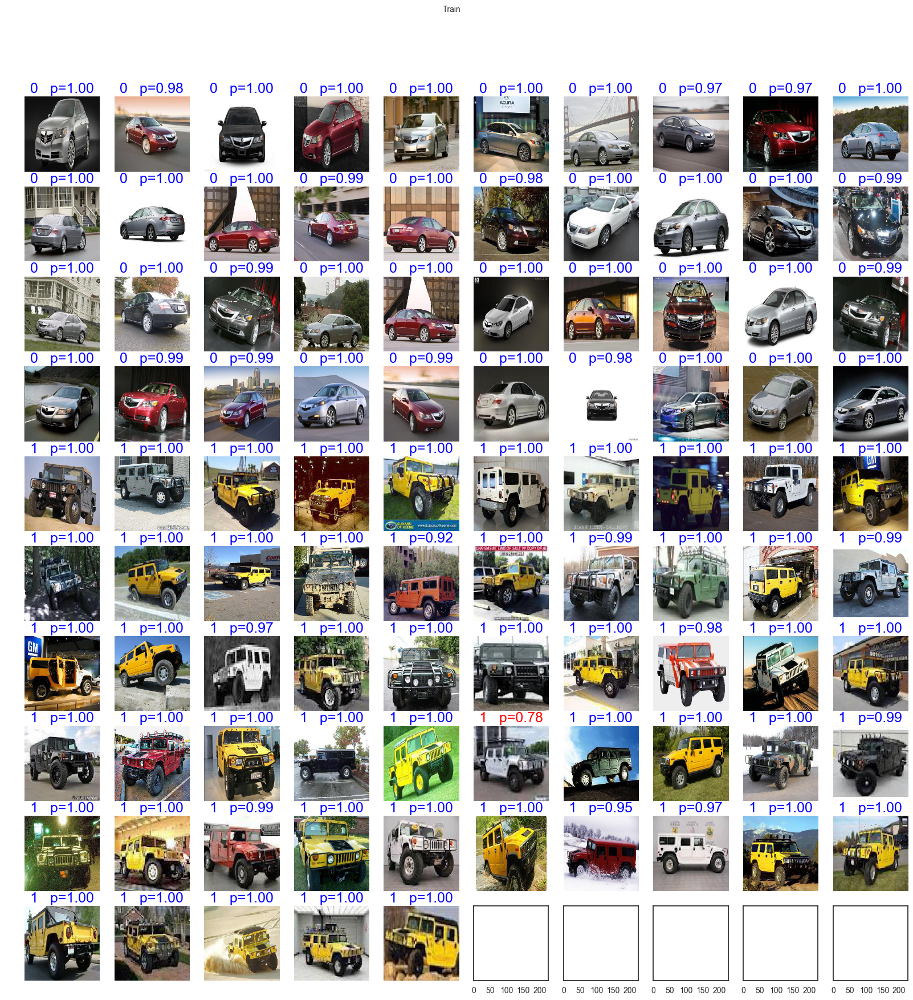

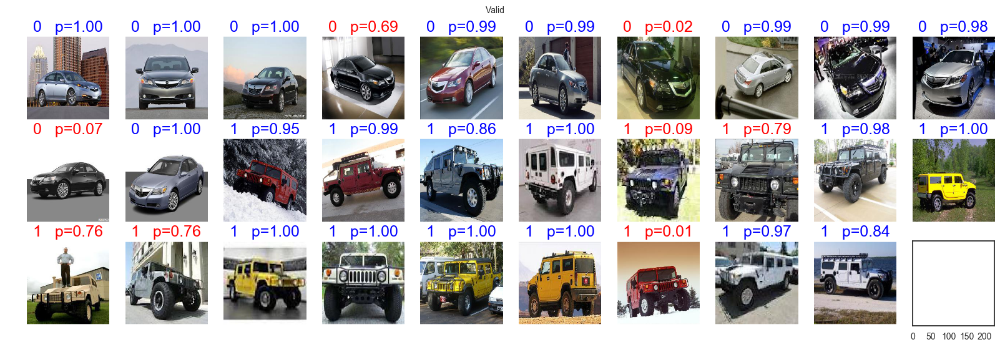

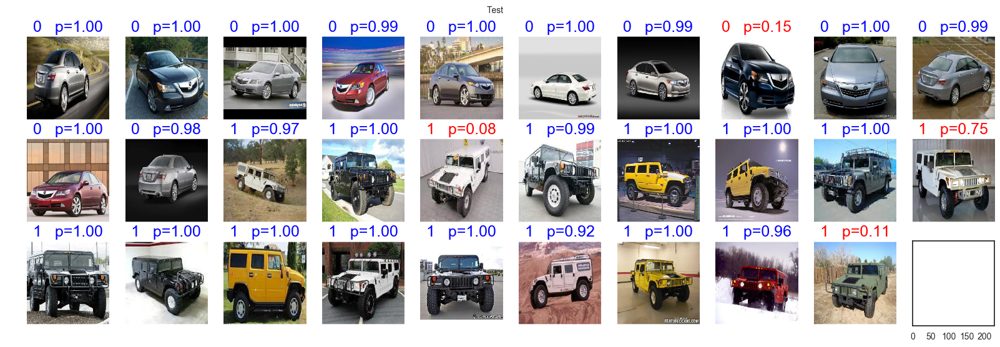

In [363]:
predict_train = model2.predict(X_train_norm)
predict_valid = model2.predict(X_valid_norm)
predict_test = model2.predict(X_test_norm)

fig = plot_data(X_train_norm, Y_train, predict_train)
fig.suptitle("Train")

fig = plot_data(X_valid_norm, Y_valid, predict_valid)
fig.suptitle("Valid")

fig = plot_data(X_test_norm, Y_test, predict_test)
fig.suptitle("Test")

Let's look at a few images from the internet. I found these manually. To be scientific, we'd want to get more data. For now, just getting an initial sense.

In [372]:
def image_from_url(url):
    response = requests.get(url)
    img = Image.open(StringIO(response.content))
    return img

In [ ]:
hummer_urls = [
    "https://upload.wikimedia.org/wikipedia/commons/thumb/5/58/2002-09-11-Marbella-22.jpg/220px-2002-09-11-Marbella-22.jpg",
    "https://s-media-cache-ak0.pinimg.com/originals/83/01/a0/8301a0d1d45e4a53e1a790fe79f6cbef.jpg",
    "http://vignette1.wikia.nocookie.net/asphalt/images/2/26/Hummer_h1.jpg/revision/latest?cb=20150120143504",
   ]

acura_urls = [
    "https://media.ed.edmunds-media.com/acura/rl/2012/oem/2012_acura_rl_sedan_base_fq_oem_6_500.jpg",
    "https://media.ed.edmunds-media.com/acura/rl/2012/oem/2012_acura_rl_sedan_base_fq_oem_3_500.jpg",
    "https://upload.wikimedia.org/wikipedia/commons/thumb/f/fc/2005_Acura_RL_--_NHTSA.jpg/1200px-2005_Acura_RL_--_NHTSA.jpg"
]

hummers = map(image_from_url, hummer_urls)
acuras = map(image_from_url, acura_urls)

instance

In [389]:
to_test = [img.resize((227,227))
           for img in hummers + acuras]
    
to_test = [np.array(img).astype('float32')/255.0
                    for img in to_test]

to_test = np.array(to_test)
to_test.shape

(6, 227, 227, 3)

In [390]:

predicts = model2.predict(to_test)
ys = np.array([[1,0],[1,0],[1,0],
              [0,1],[0,1],[0,1]])

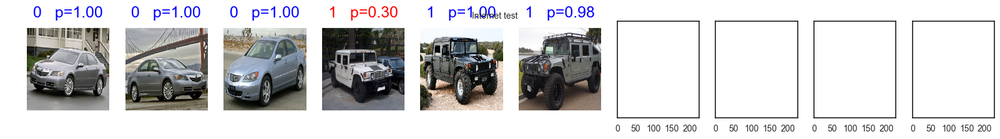

In [393]:
fig = plot_data(to_test, ys, predicts)
fig.suptitle("Internet test")

It seems to work ok. Just for fun, let's make sure we don't already have these images :)

In [408]:
def cmp_images(a,b):
    """
    Compare two images. Both must be numpy arrays, of same size, 
    float32 normalized to [0,1].
    Approximate...
    """
    if np.abs((a-b)).mean() < 0.1:  # hack, but should be good enough
        return True
    return False

cmp_images(X_train_norm[0], X_train_norm[0])

True

In [409]:
stop = False
for a in it.chain(X_train_norm, X_valid_norm, X_test_norm):
    for b in to_test:
        if cmp_images(a,b):
            fig, plots = plt.subplots(1, 2)
            plots[0].imshow(a)
            plots[1].imshow(b)


## A note on puppies

Note that our classifier divides the world into hummer and acura, and has no conception of anything else. Let's see what it does with puppies...

In [410]:
puppy_urls = [
    "http://cdn.earthporm.com/wp-content/uploads/2015/10/XX-Proud-Mommies5__605.jpg",
    "https://ipetcompanion.com/feedapuppy/styles/media/puppy.jpg",
    "https://i.ytimg.com/vi/PnY7WqoN4F8/hqdefault.jpg"
]

puppies = map(image_from_url, puppy_urls)

In [411]:
to_test = [img.resize((227,227))
           for img in puppies]
    
to_test = [np.array(img).astype('float32')/255.0
                    for img in to_test]

to_test = np.array(to_test)
to_test.shape

(3, 227, 227, 3)

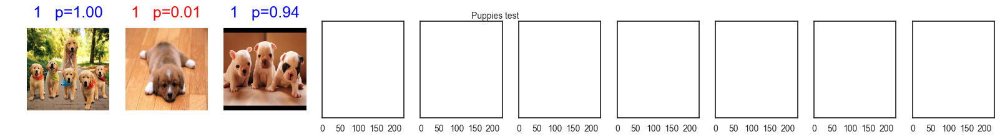

In [412]:
predicts = model2.predict(to_test)
# We'll pretend that puppies are hummers, just to make the code happy
ys = np.array([[1,0],[1,0],[1,0]])
fig = plot_data(to_test, ys, predicts)
fig.suptitle("Puppies test")

And voila -- we have two Hummer puppies and an acura puppy. The lesson: either ensure that you're only feeding your classifier data from one of the expected classes, or prepare to handle inputs that don't belong. We can include a none-of-the-above class, or predict the prob of each class independently, without using a softmax, so they can all be low at once. Either way, we'd need to feed our network enough negative data.

As a final step before moving on to a more complex problem, let's add TensorBoard so we can look at what's happening in our network.

# Problem 2

Ok, now we have basic pipeline working... let's try a more complex problem: 

- classify images as sedan, SUV, pickup, or none of the above.
- we'll use our Cars dataset, perhaps augmented with some random images



- let's start with a subtask -- classifying two classes
- another interesting task to try is distinguishing sedans/coupes from SUVs, pickups.
- a toy task is to try to classify by color -- red vs non-red.

https://github.com/rcmalli/keras-squeezenet